Sample rate: 48000 Hz, Duration: 15.00 s


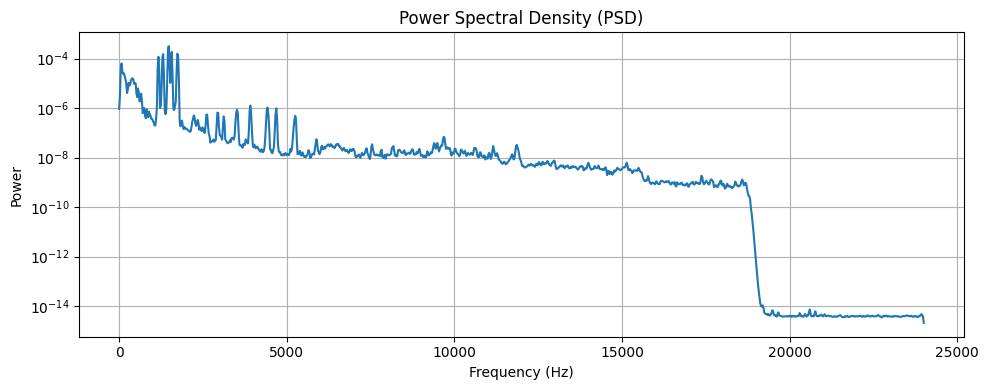

Filtered audio saved as 'restored_audio.wav'


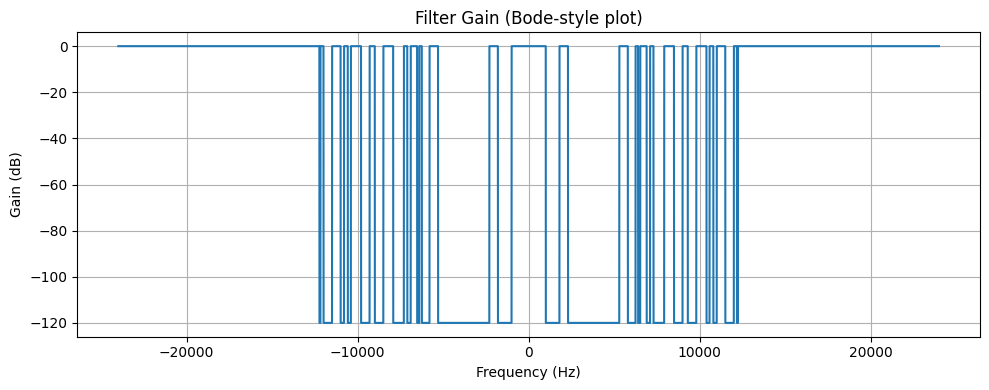

In [1]:
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt
import soundfile as sf
from scipy.signal import welch
import plotly.express as px

# Load audio
audio_path = '/content/song_with_2piccolo.wav'  # Update with your file path
y, sr = librosa.load(audio_path, sr=None)
print(f"Sample rate: {sr} Hz, Duration: {len(y)/sr:.2f} s")


y = y / np.max(np.abs(y))#normalising

# Plot PSD
f_psd, Pxx = welch(y, sr, nperseg=2048)
plt.figure(figsize=(10, 4))
plt.semilogy(f_psd, Pxx)
plt.title('Power Spectral Density (PSD)')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.grid(True)
plt.tight_layout()
plt.show()


band_to_remove = (1000, 1800)
band_to_remove2 = (7300, 7925)
band_to_remove3 = (11500, 12000)
band_to_remove4 = (8500, 9000)
band_to_remove5 = (6900, 7100)
band_to_remove6 = (5800, 6250)
band_to_remove7 = (6400, 6500)
band_to_remove9 = (6475, 6525)
band_to_remove10 = (10400, 10580)
band_to_remove11 = (9305, 9805)
band_to_remove12 = (10800, 11000)
band_to_remove13 = (12180, 12240)
band_to_remove14 = (2300, 5300) #bands analysed from the spectogram which are creating noise

# FFT
N = len(y)
yf = np.fft.fftshift(np.fft.fft(y))
freq = np.fft.fftshift(np.fft.fftfreq(N, 1/sr))

# Design band-stop filter in frequency domain
H = np.ones(N)
for band in [band_to_remove, band_to_remove2, band_to_remove3, band_to_remove4, band_to_remove5,band_to_remove6,band_to_remove7,band_to_remove9,band_to_remove10,band_to_remove11,band_to_remove12,band_to_remove13,band_to_remove14]:
    H[np.logical_and(np.abs(freq) >= band[0], np.abs(freq) <= band[1])] = 0

# Apply filter
yf_filtered = yf * H

# Inverse FFT
y_filtered = np.fft.ifft(np.fft.ifftshift(yf_filtered)).real
y_filtered = y_filtered / np.max(np.abs(y_filtered))  # Normalize

# Save cleaned audio
sf.write("restored_audio.wav", y_filtered, sr)
print("Filtered audio saved as 'restored_audio.wav'")


# Bode-style magnitude response
plt.figure(figsize=(10, 4))
plt.plot(freq, 20 * np.log10(np.abs(H) + 1e-6))  # Avoid log(0)
plt.title("Filter Gain (Bode-style plot)")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Gain (dB)")
plt.grid(True)
plt.tight_layout()


# --------- Interactive Spectrogram Function ----------
def plot_spectrogram_interactive(y_data, sr, title):
    D = librosa.stft(y_data)
    S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

    fig = px.imshow(
        S_db,
        labels=dict(x="Time", y="Frequency", color="dB"),
        x=np.arange(S_db.shape[1]) * (512 / sr),
        y=librosa.fft_frequencies(sr=sr),
        aspect='auto',
        color_continuous_scale='magma',
        origin='lower'
    )

    fig.update_layout(
        title=title,
        xaxis_title="Time (s)",
        yaxis_title="Frequency (Hz)",
        width=1000,height=400
    )
    fig.show()

plot_spectrogram_interactive(y, sr, "Original Audio Spectrogram")
plot_spectrogram_interactive(y_filtered, sr, "Filtered Audio Spectrogram")
